<a href="https://colab.research.google.com/github/vaibhavm291/ISI-INTERNSHIP/blob/main/TRIAL%20ML%20MODEL%202.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import files
uploaded = files.upload()


Saving DJI_0232.JPG to DJI_0232.JPG


In [3]:
from google.colab import files
uploaded = files.upload()


Saving DJI_0233.JPG to DJI_0233.JPG


In [4]:
from google.colab import files
uploaded = files.upload()


Saving DJI_0234.JPG to DJI_0234.JPG


In [5]:
from google.colab import files
uploaded = files.upload()


Saving DJI_0235.JPG to DJI_0235.JPG


In [6]:
from google.colab import files
uploaded = files.upload()


Saving DJI_0236.JPG to DJI_0236.JPG


In [7]:
from google.colab import files
uploaded = files.upload()


Saving DJI_0237.JPG to DJI_0237.JPG


In [8]:
from google.colab import files
uploaded = files.upload()


Saving DJI_0232.json to DJI_0232.json


In [9]:
from google.colab import files
uploaded = files.upload()


Saving DJI_0233.json to DJI_0233.json


In [10]:
from google.colab import files
uploaded = files.upload()


Saving DJI_0234.json to DJI_0234.json


In [11]:
from google.colab import files
uploaded = files.upload()


Saving DJI_0235.json to DJI_0235.json


In [12]:
from google.colab import files
uploaded = files.upload()


Saving DJI_0236.json to DJI_0236.json


In [13]:
from google.colab import files
uploaded = files.upload()


Saving DJI_0237.json to DJI_0237.json


In [14]:
import os

# Create images folder if it doesn't exist
if not os.path.exists("images"):
    os.makedirs("images")
    print("✅ Created 'images/' folder")
else:
    print("📁 'images/' folder already exists")


✅ Created 'images/' folder


In [15]:
import shutil

for i in range(232, 238):  # 232 to 237 inclusive
    filename = f"DJI_0{i}.JPG"
    try:
        shutil.move(filename, f"images/{filename}")
        print(f"✅ Moved {filename} to images/")
    except FileNotFoundError:
        print(f"❌ {filename} not found, skipping.")


✅ Moved DJI_0232.JPG to images/
✅ Moved DJI_0233.JPG to images/
✅ Moved DJI_0234.JPG to images/
✅ Moved DJI_0235.JPG to images/
✅ Moved DJI_0236.JPG to images/
✅ Moved DJI_0237.JPG to images/


In [16]:
import os
import json
from PIL import Image

# CONFIG
image_dir = "images"
output_dir = "labels"
json_files = [
    "DJI_0232.json",
    "DJI_0233.json",
    "DJI_0234.json",
    "DJI_0235.json",
    "DJI_0236.json",
    "DJI_0237.json"
]

# Ensure folders exist
os.makedirs(image_dir, exist_ok=True)
os.makedirs(output_dir, exist_ok=True)

# Class name map
class_map = {
    "1. Urban Littering (polygon annotation)": 0,
    "2. Rooftop tank (boundingbox or polygon)": 1,
    "3. Waterbodies (polygon annotation)": 2
}

for json_file in json_files:
    try:
        with open(json_file, "r") as f:
            data = json.load(f)
    except FileNotFoundError:
        print(f"❌ JSON not found: {json_file}")
        continue

    for item in data:
        raw_image_name = os.path.basename(item["data"]["image"])
        image_name_clean = raw_image_name.split("-")[-1]  # keeps just DJI_023X.JPG
        image_full_path = os.path.join(image_dir, image_name_clean)

        if not os.path.exists(image_full_path):
            print(f"⚠️ Skipping: {image_full_path} (image not uploaded)")
            continue

        image_width, image_height = Image.open(image_full_path).size
        yolo_lines = []

        for ann in item["annotations"][0]["result"]:
            if ann["type"] != "polygonlabels":
                continue

            label = ann["value"]["points"]
            class_name = ann["value"]["polygonlabels"][0]
            class_id = class_map.get(class_name, -1)

            if class_id == -1:
                print(f"❌ Unknown class in {json_file}: {class_name}")
                continue

            polygon = []
            for point in label:
                x = point[0] / 100
                y = point[1] / 100
                polygon.append(f"{x:.6f} {y:.6f}")

            yolo_lines.append(f"{class_id} " + " ".join(polygon))

        txt_filename = image_name_clean.replace(".jpg", ".txt").replace(".JPG", ".txt").replace(".png", ".txt")
        txt_path = os.path.join(output_dir, txt_filename)

        with open(txt_path, "w") as f:
            f.write("\n".join(yolo_lines))

        print(f"✅ Saved: {txt_path}")


✅ Saved: labels/DJI_0232.txt
✅ Saved: labels/DJI_0233.txt
✅ Saved: labels/DJI_0234.txt
✅ Saved: labels/DJI_0235.txt
✅ Saved: labels/DJI_0236.txt
✅ Saved: labels/DJI_0237.txt
✅ Saved: labels/DJI_0232.txt
✅ Saved: labels/DJI_0233.txt
✅ Saved: labels/DJI_0234.txt
✅ Saved: labels/DJI_0235.txt
✅ Saved: labels/DJI_0236.txt
✅ Saved: labels/DJI_0237.txt
✅ Saved: labels/DJI_0232.txt
✅ Saved: labels/DJI_0233.txt
✅ Saved: labels/DJI_0234.txt
✅ Saved: labels/DJI_0235.txt
✅ Saved: labels/DJI_0236.txt
✅ Saved: labels/DJI_0237.txt
✅ Saved: labels/DJI_0232.txt
✅ Saved: labels/DJI_0233.txt
✅ Saved: labels/DJI_0234.txt
✅ Saved: labels/DJI_0235.txt
✅ Saved: labels/DJI_0236.txt
✅ Saved: labels/DJI_0237.txt
✅ Saved: labels/DJI_0232.txt
✅ Saved: labels/DJI_0233.txt
✅ Saved: labels/DJI_0234.txt
✅ Saved: labels/DJI_0235.txt
✅ Saved: labels/DJI_0236.txt
✅ Saved: labels/DJI_0237.txt
✅ Saved: labels/DJI_0232.txt
✅ Saved: labels/DJI_0233.txt
✅ Saved: labels/DJI_0234.txt
✅ Saved: labels/DJI_0235.txt
✅ Saved: label

In [17]:
!pip install ultralytics --quiet


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 27.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 118.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 94.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 52.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 878.6 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 85.5 MB/s eta 0:00:00


In [18]:
yaml_content = """
path: /content
train: images
val: images

nc: 3
names: ['littering', 'rooftop_tank', 'waterbody']
"""

with open("landrisk.yaml", "w") as f:
    f.write(yaml_content)

print("✅ landrisk.yaml updated")


✅ landrisk.yaml updated


In [19]:
from ultralytics import YOLO

model = YOLO('yolov8m-seg.pt')
model.train(data='landrisk.yaml', epochs=100, imgsz=640)


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 52.4M/52.4M [00:00<00:00, 304MB/s]


Ultralytics 8.3.160 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=landrisk.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8m-seg.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, pro

100%|██████████| 755k/755k [00:00<00:00, 21.4MB/s]

Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

 16                  -1  1    332160  ultralytics.nn.modules.conv.Conv             [192, 192, 3, 2]              
 17            [-1, 12]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 18                  -1  2   1846272  ultralytics.nn.modules.block.C2f             [576, 384, 2]                 
 19                  -1  1   1327872  ultralytics.nn.modules.conv.Conv             [384, 384, 3, 2]              
 20             [-1, 9]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 21                  -1  2   4207104  ultralytics.nn.modules.block.C2f             [960, 576, 2]                 
 22        [15, 18, 21]  1   5160761  ultralytics.nn.modules.head.Segment          [3, 32, 192, [192, 384, 576]] 
YOLOv8m-seg summary: 191 layers, 27,241,385 parameters, 27,241,369 gradients, 110.4 GFLOPs

Transferred 531/537 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Autom

100%|██████████| 5.35M/5.35M [00:00<00:00, 75.6MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 206.8±8.0 MB/s, size: 8455.3 KB)


train: Scanning /content/labels... 6 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6/6 [00:00<00:00, 917.69it/s]

train: New cache created: /content/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2084.8±1253.6 MB/s, size: 8455.3 KB)


val: Scanning /content/labels.cache... 6 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6/6 [00:00<?, ?it/s]


Plotting labels to runs/segment/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 86 weight(decay=0.0), 97 weight(decay=0.0005), 96 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/segment/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      1/100      3.18G      2.231      5.562      4.737      1.852         76        640: 100%|██████████| 1/1 [00:02<00:00,  2.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.97it/s]

                   all          6         28    0.00611       0.35    0.00424   0.000998    0.00245      0.075    0.00269   0.000493



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      2/100      3.21G      1.875      5.394       4.16      1.921         56        640: 100%|██████████| 1/1 [00:00<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.48it/s]

                   all          6         28     0.0062      0.312    0.00545    0.00142    0.00242      0.075    0.00289   0.000847



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      3/100      3.23G      2.107      5.291      4.024      2.081         51        640: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.51it/s]

                   all          6         28    0.00625      0.312    0.00574    0.00206    0.00245      0.075    0.00315   0.000942



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      4/100      3.23G      2.271      5.305      4.505      2.097         58        640: 100%|██████████| 1/1 [00:00<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.69it/s]

                   all          6         28    0.00698      0.375    0.00649    0.00246    0.00245      0.075    0.00321   0.000948



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      5/100      3.23G      2.116      5.674      4.342      1.984         50        640: 100%|██████████| 1/1 [00:00<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.28it/s]

                   all          6         28    0.00695      0.375    0.00652    0.00252    0.00242      0.075    0.00321    0.00104



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      6/100      3.23G      2.125      5.213      4.453      1.996         75        640: 100%|██████████| 1/1 [00:00<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.14it/s]

                   all          6         28       0.24       0.15     0.0848     0.0345      0.196     0.0875     0.0537     0.0235



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      7/100      3.31G      2.145      4.465      3.347      2.048         68        640: 100%|██████████| 1/1 [00:00<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.46it/s]

                   all          6         28      0.755      0.365      0.363      0.207      0.704      0.275      0.266      0.122



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      8/100      3.38G      1.761      3.933      2.535        1.8         48        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.01it/s]

                   all          6         28      0.713      0.395      0.451      0.271      0.785      0.275      0.352      0.128



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      9/100      3.46G       1.76      3.989      2.478      1.731         53        640: 100%|██████████| 1/1 [00:00<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.13it/s]

                   all          6         28      0.592       0.36      0.399      0.274      0.579      0.353      0.359      0.136



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     10/100      3.68G      1.875      3.704      2.171      1.789         70        640: 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.95it/s]


                   all          6         28      0.699      0.439       0.46      0.294      0.589      0.377      0.389      0.156

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     11/100      3.82G      1.959       3.83      2.301      1.778         64        640: 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.58it/s]

                   all          6         28      0.618      0.487      0.462      0.328      0.618      0.487      0.455      0.198



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     12/100      3.95G      1.439      3.442      1.842      1.551         57        640: 100%|██████████| 1/1 [00:00<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.90it/s]

                   all          6         28      0.688      0.537       0.63      0.433      0.688      0.537      0.575      0.276



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     13/100      4.19G      1.653      3.779      2.112       1.63         83        640: 100%|██████████| 1/1 [00:00<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.24it/s]


                   all          6         28      0.568      0.725      0.685      0.501      0.503      0.575      0.536       0.29

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     14/100      4.51G      1.451      3.242      1.871      1.537         59        640: 100%|██████████| 1/1 [00:00<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.71it/s]

                   all          6         28      0.573      0.708      0.769      0.564      0.432      0.532      0.518      0.247



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     15/100      4.51G      1.525      3.159      1.956       1.58         57        640: 100%|██████████| 1/1 [00:00<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.63it/s]

                   all          6         28      0.437      0.705      0.578      0.362      0.319      0.468      0.302      0.135



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     16/100      4.51G       1.33      2.499      1.608      1.364         64        640: 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.12it/s]

                   all          6         28      0.535      0.709      0.664      0.407      0.495      0.587       0.47      0.222



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     17/100      4.51G      1.213      2.409      1.405      1.294         92        640: 100%|██████████| 1/1 [00:00<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.60it/s]

                   all          6         28      0.534      0.675      0.531      0.347        0.5      0.613      0.514      0.233



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     18/100      4.51G      1.153       2.67      1.492      1.339         65        640: 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all          6         28      0.534      0.675      0.531      0.347        0.5      0.613      0.514      0.233



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     19/100      4.51G       1.23      2.702      1.618      1.344         56        640: 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.10it/s]

                   all          6         28      0.749      0.707       0.74      0.581        0.7       0.64      0.665      0.374



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     20/100      4.51G      1.218      2.451      1.287      1.343         66        640: 100%|██████████| 1/1 [00:00<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.99it/s]

                   all          6         28      0.749      0.707       0.74      0.581        0.7       0.64      0.665      0.374



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     21/100      4.51G      1.085      2.672      1.391      1.252         54        640: 100%|██████████| 1/1 [00:00<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.11it/s]


                   all          6         28      0.706      0.681      0.736      0.564      0.623      0.562      0.566      0.357

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     22/100      4.51G      1.184      2.376      1.423      1.341         64        640: 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.62it/s]

                   all          6         28      0.706      0.681      0.736      0.564      0.623      0.562      0.566      0.357



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     23/100      4.51G      1.351      2.059      1.453      1.306         74        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.50it/s]


                   all          6         28      0.834      0.611      0.755      0.564      0.694      0.489        0.6      0.332

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     24/100      4.51G      1.107      2.104      1.316      1.241         71        640: 100%|██████████| 1/1 [00:00<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.98it/s]

                   all          6         28      0.834      0.611      0.755      0.564      0.694      0.489        0.6      0.332



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     25/100      4.51G      1.272      2.344      1.575      1.411         52        640: 100%|██████████| 1/1 [00:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.05it/s]

                   all          6         28      0.762      0.825      0.837      0.604      0.635      0.585      0.596      0.338



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     26/100      4.51G      1.202      2.234      1.371       1.36         49        640: 100%|██████████| 1/1 [00:00<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.41it/s]

                   all          6         28      0.762      0.825      0.837      0.604      0.635      0.585      0.596      0.338



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     27/100      4.51G      1.097      2.069      1.322      1.269         52        640: 100%|██████████| 1/1 [00:00<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.92it/s]


                   all          6         28      0.781        0.8      0.889      0.605      0.705      0.675      0.663      0.374

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     28/100      4.51G      1.125      2.279       1.12      1.224         66        640: 100%|██████████| 1/1 [00:00<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.66it/s]

                   all          6         28      0.781        0.8      0.889      0.605      0.705      0.675      0.663      0.374



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     29/100      4.51G      1.033      1.984      1.113      1.167         61        640: 100%|██████████| 1/1 [00:00<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.84it/s]

                   all          6         28      0.739      0.822      0.839      0.616      0.688      0.693      0.699      0.439



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     30/100      4.51G      1.248      2.046      1.422      1.415         56        640: 100%|██████████| 1/1 [00:00<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.03it/s]

                   all          6         28      0.739      0.822      0.839      0.616      0.688      0.693      0.699      0.439



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     31/100      4.51G      1.035       1.91      1.159       1.21         55        640: 100%|██████████| 1/1 [00:00<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]

                   all          6         28      0.791      0.917      0.919      0.712      0.766       0.88      0.909      0.513



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     32/100      4.51G      1.118      2.243      1.427       1.23         38        640: 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.58it/s]


                   all          6         28      0.791      0.917      0.919      0.712      0.766       0.88      0.909      0.513

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     33/100      4.51G      1.196      2.239      1.196      1.276         54        640: 100%|██████████| 1/1 [00:00<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.25it/s]

                   all          6         28      0.851      0.909      0.931      0.693      0.824      0.886      0.911      0.508



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     34/100      4.56G      1.093      2.075      1.353      1.332         43        640: 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.19it/s]

                   all          6         28      0.851      0.909      0.931      0.693      0.824      0.886      0.911      0.508



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     35/100      4.65G      1.205      2.592      1.254      1.289         49        640: 100%|██████████| 1/1 [00:00<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.34it/s]

                   all          6         28      0.696        0.8      0.854      0.629      0.696        0.8      0.848      0.504



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     36/100      4.67G       1.09      2.049      1.087      1.092         87        640: 100%|██████████| 1/1 [00:00<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.36it/s]


                   all          6         28      0.696        0.8      0.854      0.629      0.696        0.8      0.848      0.504

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     37/100      4.67G      1.251      2.426      1.381      1.404         44        640: 100%|██████████| 1/1 [00:00<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.16it/s]


                   all          6         28      0.575        0.9      0.759      0.512      0.601      0.889      0.772      0.457

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     38/100      4.67G      1.014      1.639     0.8789      1.097         65        640: 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.57it/s]

                   all          6         28      0.575        0.9      0.759      0.512      0.601      0.889      0.772      0.457



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     39/100      4.67G      1.086       1.68     0.9866       1.16         63        640: 100%|██████████| 1/1 [00:00<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.15it/s]

                   all          6         28      0.727      0.625      0.736      0.506      0.727      0.625      0.727      0.442



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     40/100      4.67G      1.045      1.706      1.082      1.236         63        640: 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.07it/s]


                   all          6         28      0.727      0.625      0.736      0.506      0.727      0.625      0.727      0.442

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     41/100      4.67G      1.035      1.857      1.065      1.275         55        640: 100%|██████████| 1/1 [00:00<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.27it/s]

                   all          6         28      0.687      0.825      0.872      0.622      0.687      0.825      0.867      0.558



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     42/100      4.67G     0.9908      1.635     0.9504      1.156         51        640: 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.03it/s]

                   all          6         28      0.687      0.825      0.872      0.622      0.687      0.825      0.867      0.558



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     43/100      4.67G     0.8989      1.612     0.8983      1.095         71        640: 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.86it/s]

                   all          6         28      0.784      0.856      0.939      0.702      0.784      0.856      0.937      0.576



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     44/100      4.67G     0.8627      1.577     0.8984      1.057         60        640: 100%|██████████| 1/1 [00:00<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.91it/s]

                   all          6         28      0.784      0.856      0.939      0.702      0.784      0.856      0.937      0.576



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     45/100      4.67G      1.038       1.86      0.997      1.198         62        640: 100%|██████████| 1/1 [00:00<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.13it/s]


                   all          6         28      0.862      0.965      0.974      0.718      0.862      0.965       0.97      0.576

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     46/100      4.67G      1.166       1.89      1.045      1.253         45        640: 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.84it/s]


                   all          6         28      0.862      0.965      0.974      0.718      0.862      0.965       0.97      0.576

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     47/100      4.67G     0.9144       1.72     0.9246      1.127         51        640: 100%|██████████| 1/1 [00:00<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.23it/s]


                   all          6         28      0.721       0.95      0.921      0.712      0.742      0.975      0.922      0.566

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     48/100      4.67G      1.111      1.842      1.059      1.201         47        640: 100%|██████████| 1/1 [00:00<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.25it/s]

                   all          6         28      0.721       0.95      0.921      0.712      0.742      0.975      0.922      0.566



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     49/100      4.67G     0.9811      1.786      1.008      1.141         68        640: 100%|██████████| 1/1 [00:00<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.02it/s]

                   all          6         28       0.73       0.95      0.911      0.725      0.728       0.95      0.922      0.641



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     50/100      4.67G      1.022      1.884     0.8869      1.154         58        640: 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.32it/s]


                   all          6         28       0.73       0.95      0.911      0.725      0.728       0.95      0.922      0.641

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     51/100      4.67G     0.9193      1.606     0.8486      1.107         80        640: 100%|██████████| 1/1 [00:00<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.22it/s]

                   all          6         28      0.729      0.907      0.874      0.701      0.729      0.907      0.869      0.615



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     52/100      4.67G     0.8192      1.315     0.8041      1.099         59        640: 100%|██████████| 1/1 [00:00<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.19it/s]

                   all          6         28      0.729      0.907      0.874      0.701      0.729      0.907      0.869      0.615



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     53/100      4.67G      1.059      1.605     0.9915      1.267         44        640: 100%|██████████| 1/1 [00:00<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.74it/s]

                   all          6         28      0.729      0.907      0.874      0.701      0.729      0.907      0.869      0.615



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     54/100      4.67G     0.9001       1.36     0.7701      1.095         67        640: 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.21it/s]

                   all          6         28      0.719      0.906      0.883      0.676      0.719      0.906      0.874      0.575



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     55/100      4.67G     0.8612      1.762     0.8559      1.048         61        640: 100%|██████████| 1/1 [00:00<00:00,  3.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.07it/s]

                   all          6         28      0.719      0.906      0.883      0.676      0.719      0.906      0.874      0.575



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     56/100      4.67G     0.7426      1.356     0.6896      1.014         58        640: 100%|██████████| 1/1 [00:00<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.44it/s]

                   all          6         28      0.719      0.906      0.883      0.676      0.719      0.906      0.874      0.575



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     57/100      4.67G     0.8372      1.503     0.8671      1.153         59        640: 100%|██████████| 1/1 [00:00<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.86it/s]

                   all          6         28      0.762       0.91      0.952       0.74      0.762       0.91      0.952      0.612



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     58/100      4.67G     0.8898      1.563      0.802      1.108         62        640: 100%|██████████| 1/1 [00:00<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.04it/s]

                   all          6         28      0.762       0.91      0.952       0.74      0.762       0.91      0.952      0.612



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     59/100      4.67G     0.9478      1.344     0.7914      1.054         67        640: 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.82it/s]

                   all          6         28      0.762       0.91      0.952       0.74      0.762       0.91      0.952      0.612



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     60/100      4.67G     0.9424      1.517     0.7662      1.032         50        640: 100%|██████████| 1/1 [00:00<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.77it/s]

                   all          6         28      0.787      0.908      0.972       0.74      0.787      0.908      0.972      0.584



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     61/100      4.67G     0.7489      1.444     0.6939      1.009         53        640: 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.87it/s]

                   all          6         28      0.787      0.908      0.972       0.74      0.787      0.908      0.972      0.584



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     62/100      4.67G     0.8621      1.433     0.7817      1.135         54        640: 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.85it/s]

                   all          6         28      0.787      0.908      0.972       0.74      0.787      0.908      0.972      0.584



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     63/100      4.67G     0.8218      1.662     0.7102       1.01         69        640: 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.62it/s]

                   all          6         28      0.868      0.906      0.991      0.767      0.868      0.906      0.991      0.609



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     64/100      4.67G     0.8215       1.66     0.8032      1.055         69        640: 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.33it/s]

                   all          6         28      0.868      0.906      0.991      0.767      0.868      0.906      0.991      0.609



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     65/100      4.67G     0.8143      1.383     0.6655      1.001         59        640: 100%|██████████| 1/1 [00:00<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.11it/s]


                   all          6         28      0.868      0.906      0.991      0.767      0.868      0.906      0.991      0.609

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     66/100      4.67G      0.864      1.473     0.8495      1.103         57        640: 100%|██████████| 1/1 [00:00<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.15it/s]

                   all          6         28      0.873      0.917      0.982      0.763      0.873      0.917      0.982      0.648



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     67/100      4.67G     0.7657      1.274     0.6736      1.054         52        640: 100%|██████████| 1/1 [00:00<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.83it/s]

                   all          6         28      0.873      0.917      0.982      0.763      0.873      0.917      0.982      0.648



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     68/100      4.67G     0.8425      1.411     0.7134      1.065         74        640: 100%|██████████| 1/1 [00:00<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.86it/s]


                   all          6         28      0.873      0.917      0.982      0.763      0.873      0.917      0.982      0.648

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     69/100      4.67G     0.7766      1.415     0.8045      1.036         74        640: 100%|██████████| 1/1 [00:00<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.01it/s]

                   all          6         28      0.918      0.927      0.995      0.768      0.918      0.927      0.995      0.688



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     70/100      4.67G     0.7948      1.406      0.712      1.042         69        640: 100%|██████████| 1/1 [00:00<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.29it/s]

                   all          6         28      0.918      0.927      0.995      0.768      0.918      0.927      0.995      0.688



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     71/100      4.67G     0.7949      1.242     0.7036      1.017         69        640: 100%|██████████| 1/1 [00:00<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.20it/s]

                   all          6         28      0.918      0.927      0.995      0.768      0.918      0.927      0.995      0.688



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     72/100      4.67G     0.8395      1.432     0.7405      1.105         48        640: 100%|██████████| 1/1 [00:00<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.31it/s]

                   all          6         28       0.95      0.979      0.995      0.821       0.95      0.979      0.995      0.726



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     73/100      4.67G     0.8288      1.296     0.7216      1.047         53        640: 100%|██████████| 1/1 [00:00<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.03it/s]

                   all          6         28       0.95      0.979      0.995      0.821       0.95      0.979      0.995      0.726



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     74/100      4.67G     0.8357      1.317      0.715     0.9962         56        640: 100%|██████████| 1/1 [00:00<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.25it/s]


                   all          6         28       0.95      0.979      0.995      0.821       0.95      0.979      0.995      0.726

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     75/100      4.67G     0.8138      1.502      0.792      1.071         56        640: 100%|██████████| 1/1 [00:00<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.61it/s]

                   all          6         28      0.908      0.913      0.995      0.842      0.908      0.913      0.995      0.723



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     76/100      4.67G     0.8113      1.584     0.7986      1.091         61        640: 100%|██████████| 1/1 [00:00<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.61it/s]

                   all          6         28      0.908      0.913      0.995      0.842      0.908      0.913      0.995      0.723



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     77/100      4.67G     0.6668       1.12     0.5906      1.005         65        640: 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.80it/s]

                   all          6         28      0.908      0.913      0.995      0.842      0.908      0.913      0.995      0.723



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     78/100      4.67G     0.6906      1.226     0.6262     0.9783         69        640: 100%|██████████| 1/1 [00:00<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.42it/s]

                   all          6         28      0.921      0.998      0.995      0.877      0.921      0.998      0.995      0.726



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     79/100      4.67G     0.7038      1.055     0.6057     0.9767         68        640: 100%|██████████| 1/1 [00:00<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.87it/s]


                   all          6         28      0.921      0.998      0.995      0.877      0.921      0.998      0.995      0.726

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     80/100      4.67G     0.9769      1.606      1.019      1.239         40        640: 100%|██████████| 1/1 [00:00<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.49it/s]


                   all          6         28      0.921      0.998      0.995      0.877      0.921      0.998      0.995      0.726

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     81/100      4.67G     0.7873      1.422     0.7356      1.018         59        640: 100%|██████████| 1/1 [00:00<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.04it/s]


                   all          6         28          1      0.955      0.995      0.882          1      0.955      0.995      0.733

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     82/100      4.67G     0.7853      1.437     0.7466      1.065         46        640: 100%|██████████| 1/1 [00:00<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.21it/s]

                   all          6         28          1      0.955      0.995      0.882          1      0.955      0.995      0.733



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     83/100      4.67G     0.7538      1.285     0.6981      1.013         56        640: 100%|██████████| 1/1 [00:00<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.35it/s]

                   all          6         28          1      0.955      0.995      0.882          1      0.955      0.995      0.733



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     84/100      4.67G     0.7752      1.205     0.6164      1.003         64        640: 100%|██████████| 1/1 [00:00<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.25it/s]

                   all          6         28      0.987          1      0.995      0.862      0.987          1      0.995      0.754



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     85/100      4.67G     0.7082      1.008     0.6331      1.056         52        640: 100%|██████████| 1/1 [00:00<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.68it/s]

                   all          6         28      0.987          1      0.995      0.862      0.987          1      0.995      0.754



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     86/100      4.67G       0.68      1.165     0.6238     0.9749         65        640: 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.78it/s]

                   all          6         28      0.987          1      0.995      0.862      0.987          1      0.995      0.754



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     87/100      4.67G      0.936      1.443     0.6443      1.033         59        640: 100%|██████████| 1/1 [00:00<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.12it/s]


                   all          6         28      0.987          1      0.995      0.862      0.987          1      0.995      0.754

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     88/100      4.67G     0.7104      1.367     0.6364      1.016         53        640: 100%|██████████| 1/1 [00:00<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.28it/s]

                   all          6         28      0.989          1      0.995      0.904      0.989          1      0.995      0.764



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     89/100      4.67G      0.711      1.278     0.6884       1.03         52        640: 100%|██████████| 1/1 [00:00<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.10it/s]

                   all          6         28      0.989          1      0.995      0.904      0.989          1      0.995      0.764



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     90/100      4.67G     0.7958       1.38     0.6944      1.003         81        640: 100%|██████████| 1/1 [00:00<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.25it/s]


                   all          6         28      0.989          1      0.995      0.904      0.989          1      0.995      0.764
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     91/100      4.67G     0.5816      1.226     0.7072     0.9714         26        640: 100%|██████████| 1/1 [00:02<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.19it/s]

                   all          6         28      0.989          1      0.995      0.904      0.989          1      0.995      0.764



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     92/100      4.67G     0.7756       1.37     0.8147     0.9847         28        640: 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.66it/s]

                   all          6         28      0.988          1      0.995      0.898      0.988          1      0.995       0.77



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     93/100      4.67G     0.7439      1.308     0.7906      1.031         28        640: 100%|██████████| 1/1 [00:00<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.69it/s]

                   all          6         28      0.988          1      0.995      0.898      0.988          1      0.995       0.77



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     94/100      4.67G     0.6219      1.262     0.6838     0.8998         27        640: 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.03it/s]

                   all          6         28      0.988          1      0.995      0.898      0.988          1      0.995       0.77



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     95/100      4.67G      0.793      1.533     0.8564     0.9314         28        640: 100%|██████████| 1/1 [00:00<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.84it/s]

                   all          6         28      0.988          1      0.995      0.898      0.988          1      0.995       0.77



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     96/100      4.67G     0.6995      1.153     0.7636      1.024         26        640: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.88it/s]

                   all          6         28      0.988          1      0.995      0.891      0.988          1      0.995      0.772



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     97/100      4.67G     0.5966      1.091     0.6182     0.9485         27        640: 100%|██████████| 1/1 [00:00<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.32it/s]

                   all          6         28      0.988          1      0.995      0.891      0.988          1      0.995      0.772



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     98/100      4.67G     0.5986       1.06     0.6465     0.9653         26        640: 100%|██████████| 1/1 [00:00<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.88it/s]

                   all          6         28      0.988          1      0.995      0.891      0.988          1      0.995      0.772



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     99/100      4.67G     0.7948      1.142     0.7355      1.069         27        640: 100%|██████████| 1/1 [00:00<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.39it/s]

                   all          6         28      0.988          1      0.995      0.891      0.988          1      0.995      0.772



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    100/100      4.67G     0.6174     0.9883     0.6744     0.8901         27        640: 100%|██████████| 1/1 [00:00<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.75it/s]

                   all          6         28      0.992          1      0.995      0.906      0.992          1      0.995      0.782



100 epochs completed in 0.086 hours.
Optimizer stripped from runs/segment/train/weights/last.pt, 54.8MB
Optimizer stripped from runs/segment/train/weights/best.pt, 54.8MB

Validating runs/segment/train/weights/best.pt...
Ultralytics 8.3.160 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8m-seg summary (fused): 105 layers, 27,224,121 parameters, 0 gradients, 110.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   0%|          | 0/1 [00:00<?, ?it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.73it/s]


                   all          6         28      0.992          1      0.995      0.907      0.992          1      0.995      0.778
             littering          6         20      0.997          1      0.995      0.881      0.997          1      0.995      0.723
             waterbody          5          8      0.986          1      0.995      0.932      0.986          1      0.995      0.833
Speed: 0.2ms preprocess, 11.1ms inference, 0.0ms loss, 2.9ms postprocess per image
Results saved to runs/segment/train


ultralytics.utils.metrics.SegmentMetrics object with attributes:

ap_class_index: array([0, 2])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7fac8db68d90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(M)', 'F1-Confidence(M)', 'Precision-Confidence(M)', 'Recall-Confidence(M)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.04104

In [20]:
from ultralytics import YOLO

model = YOLO('runs/segment/train/weights/best.pt')  # or adjust path
results = model.predict(source='images/DJI_0232.JPG', save=True)



image 1/1 /content/images/DJI_0232.JPG: 384x640 1 littering, 1 waterbody, 65.3ms
Speed: 2.9ms preprocess, 65.3ms inference, 17.7ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/segment/predict


In [21]:
!ls runs/segment/predict


DJI_0232.jpg


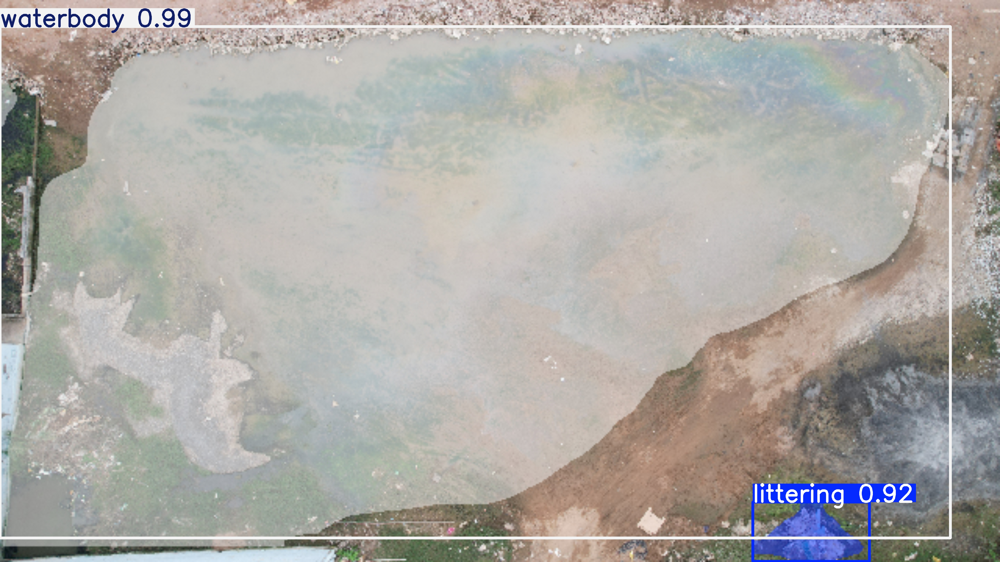

In [22]:
from IPython.display import Image
Image(filename='runs/segment/predict/DJI_0232.jpg')


In [23]:
from google.colab import files
uploaded = files.upload()

Saving DJI_0873.JPG to DJI_0873.JPG


In [24]:
from ultralytics import YOLO

model = YOLO('runs/segment/train/weights/best.pt')  # or wherever your trained model lives
results = model.predict(source='DJI_0873.JPG', save=True)



image 1/1 /content/DJI_0873.JPG: 384x640 3 litterings, 5 waterbodys, 32.1ms
Speed: 2.9ms preprocess, 32.1ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/segment/predict2


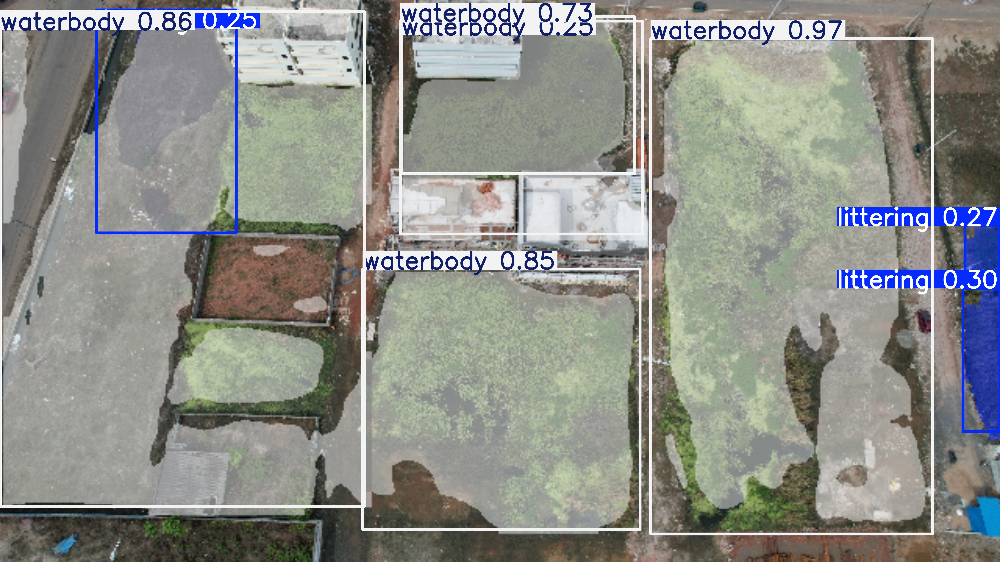

In [26]:
from IPython.display import Image
Image(filename='runs/segment/predict2/DJI_0873.jpg')


In [27]:
from google.colab import files
uploaded = files.upload()

Saving DJI_0875.JPG to DJI_0875.JPG


In [28]:
from ultralytics import YOLO

model = YOLO('runs/segment/train/weights/best.pt')  # or wherever your trained model lives
results = model.predict(source='DJI_0875.JPG', save=True)



image 1/1 /content/DJI_0875.JPG: 384x640 4 waterbodys, 33.4ms
Speed: 3.7ms preprocess, 33.4ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/segment/predict3


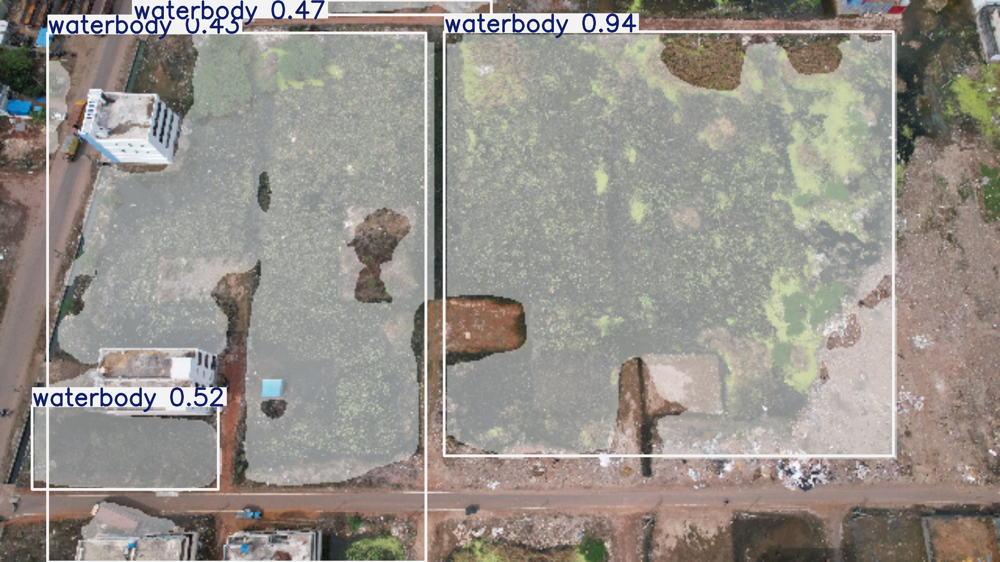

In [30]:
from IPython.display import Image
Image(filename='runs/segment/predict3/DJI_0875.jpg')


In [31]:
from google.colab import files
uploaded = files.upload()

Saving DJI_0882.JPG to DJI_0882.JPG


In [32]:
from ultralytics import YOLO

model = YOLO('runs/segment/train/weights/best.pt')  # or wherever your trained model lives
results = model.predict(source='DJI_0882.JPG', save=True)



image 1/1 /content/DJI_0882.JPG: 384x640 1 waterbody, 31.9ms
Speed: 2.7ms preprocess, 31.9ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/segment/predict4


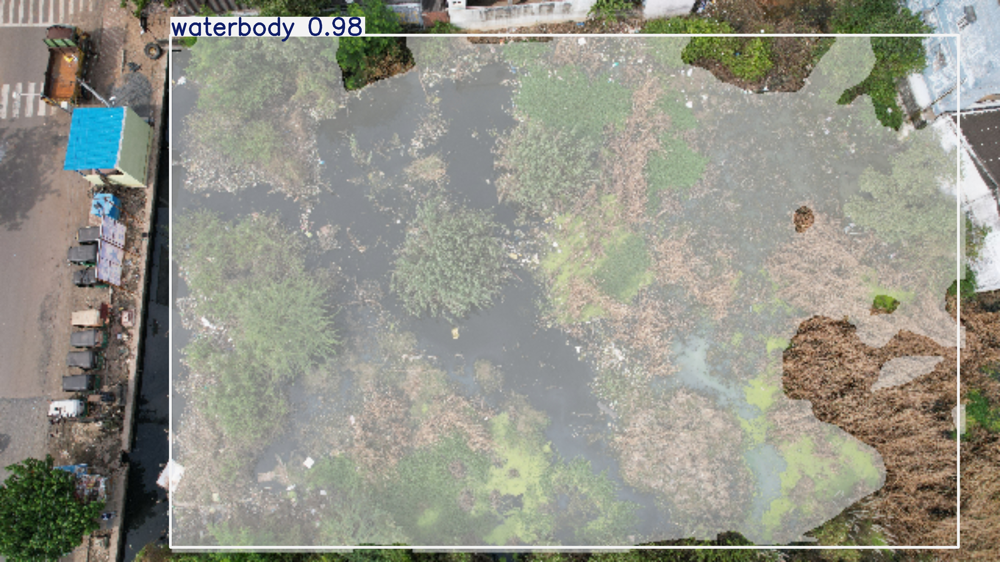

In [33]:
from IPython.display import Image
Image(filename='runs/segment/predict4/DJI_0882.jpg')


In [34]:
from google.colab import files
uploaded = files.upload()

Saving DJI_0884.JPG to DJI_0884.JPG


In [35]:
from ultralytics import YOLO

model = YOLO('runs/segment/train/weights/best.pt')  # or wherever your trained model lives
results = model.predict(source='DJI_0884.JPG', save=True)



image 1/1 /content/DJI_0884.JPG: 384x640 1 waterbody, 31.9ms
Speed: 21.2ms preprocess, 31.9ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/segment/predict5


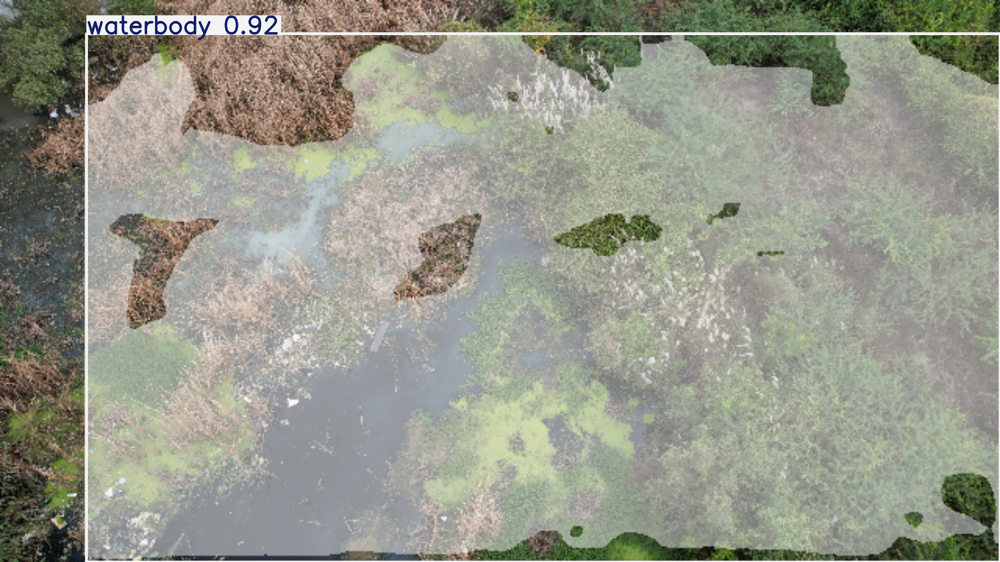

In [36]:
from IPython.display import Image
Image(filename='runs/segment/predict5/DJI_0884.jpg')


In [37]:
from google.colab import files
uploaded = files.upload()

Saving DJI_0889.JPG to DJI_0889.JPG


In [38]:
from ultralytics import YOLO

model = YOLO('runs/segment/train/weights/best.pt')  # or wherever your trained model lives
results = model.predict(source='DJI_0889.JPG', save=True)



image 1/1 /content/DJI_0889.JPG: 384x640 3 litterings, 4 waterbodys, 32.2ms
Speed: 2.8ms preprocess, 32.2ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/segment/predict6


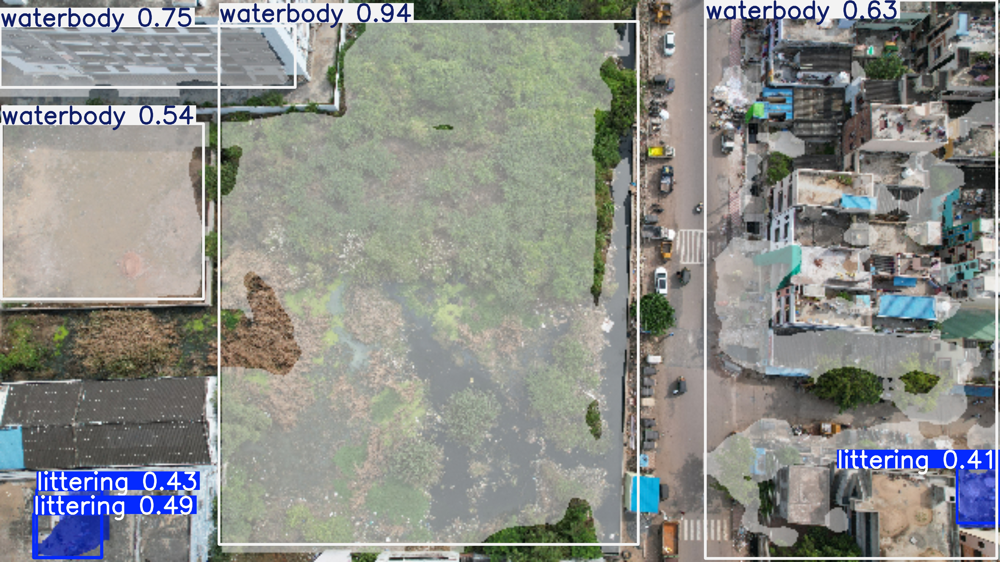

In [39]:
from IPython.display import Image
Image(filename='runs/segment/predict6/DJI_0889.jpg')
